Total de pontos lidos: 1000


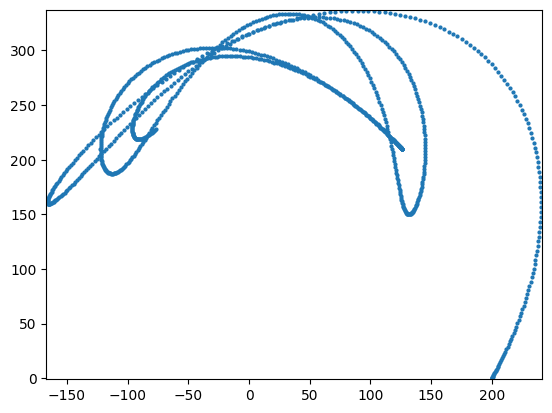

In [1]:
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import numpy as np
import re
matplotlib.rcParams['animation.embed_limit'] = 40

# Ler os dados do arquivo output.txt
xy_pairs = []
with open('output.txt', 'r') as f:
    for line in f:
        # Procurar por linhas no formato: (x, y),
        match = re.search(r'\(([\-\d.]+)\s*,\s*([\-\d.]+)\s*\)', line)
        if match:
            x = float(match.group(1))
            y = float(match.group(2))
            xy_pairs.append((x, y))

print(f"Total de pontos lidos: {len(xy_pairs)}"),

x_data = [pair[0] for pair in xy_pairs]
y_data = [pair[1] for pair in xy_pairs]

fig, ax = plt.subplots()
ax.set_xlim(min(x_data) - 1, max(x_data) + 1)
ax.set_ylim(min(y_data) - 1, max(y_data) + 1)

scatter = ax.scatter([], [], s=4)

def update(frame):
    x = x_data[:frame + 1]
    y = y_data[:frame + 1]
    data = np.stack([x, y]).T
    scatter.set_offsets(data)
    return scatter,

ani = FuncAnimation(fig, update, frames=len(xy_pairs), interval=500, blit=True, repeat=False)

from IPython.display import HTML
HTML(ani.to_jshtml())